# Appliances Energy Data Exploratory Data Analysis

## Import Necessary Libraries

In [1]:
## Import necessary libraries
from urllib.parse import quote

## Import necessary API
import sys
sys.path.append('../../../../')
from api.v2.util.data_load import data_load
from api.v2.util.get_tag_name import show_column
from api.v2.eda.Data_Info import Data_Info
from api.v2.eda.Statistical_test import adf_test, kpss_test, pp_test, ljung_box_test, arch_test, vif_test
from api.v2.eda.Visualize_EDA import Visualize_EDA

## Set Appliances Energy Data Base Parameter

In [2]:
# Set Appliance Energy Data Base Parameter

# Set MachBase Neo URL address
URL = 'http://127.0.0.1:5654'
# Set Tag Table Name
table = 'appliance_energy'
# Set TimeFormat - > 'default' or '2006-01-02 15:04:05.000000'(Divided down to the nanosecond)
timeformat = 'Default'
# Set resample Option -> D(day), H(hour), T(minute), S(second)
resample_freq = None

## Check Appliance Energy Data Info

In [3]:
# Print Appliance Energy DataInfo
Data_Info(URL, table, timeformat, resample_freq)

Tag List: ['Appliances', 'Press_mm_hg', 'RH_1', 'RH_2', 'RH_3', 'RH_4', 'RH_5', 'RH_6', 'RH_7', 'RH_8', 'RH_9', 'RH_out', 'T1', 'T2', 'T3', 'T4', 'T5', 'T6', 'T7', 'T8', 'T9', 'T_out', 'Tdewpoint', 'Visibility', 'Windspeed', 'lights', 'rv1', 'rv2']
--------------------------------------------
Number of data: 19735
--------------------------------------------
Start Time: 2016-01-11 17:00:00
End Time: 2016-05-27 18:00:00
--------------------------------------------
Missing Values: 0
--------------------------------------------
Smallest time interval: 600.00 seconds
Largest time interval: 600.00 seconds
--------------------------------------------
Maximum sampling rate (per second): 0.0016666666666666668 Hz
--------------------------------------------


## Set Appliance Energy Data Extra Parmeter
* Set based on the information confirmed in the previous step

In [4]:
# Set the desired tag names
tags = show_column(URL, table)
# Wrap each item in the list with single quotes and separate with commas
tags_ = ",".join(f"'{tag}'" for tag in tags)
# Set Tag Name
name = quote(tags_, safe=":/")
# Set Start time
start_time = '2016-01-11 17:00:00'
# Set End time 
end_time = '2016-05-27 18:00:00'
# Set TimeFormat - > 'default' or quote('2006-01-02 15:04:05.000000')(Divided down to the nanosecond)
timeformat = 'default'

In [5]:
# Appliance Energy Data Load
df = data_load(URL, table, name, start_time, end_time, timeformat, resample_freq)

In [6]:
df

NAME,Appliances,Press_mm_hg,RH_1,RH_2,RH_3,RH_4,RH_5,RH_6,RH_7,RH_8,...,T7,T8,T9,T_out,Tdewpoint,Visibility,Windspeed,lights,rv1,rv2
TIME,,,,,,,,,,,,,,,,,,,,,
2016-01-11 17:00:00,60.0,733.5,47.596667,44.790000,44.730000,45.566667,55.200000,84.256667,41.626667,48.900000,...,17.200000,18.2000,17.033333,6.600000,5.300000,63.000000,7.000000,30.0,13.275433,13.275433
2016-01-11 17:10:00,60.0,733.6,46.693333,44.722500,44.790000,45.992500,55.200000,84.063333,41.560000,48.863333,...,17.200000,18.2000,17.066667,6.483333,5.200000,59.166667,6.666667,30.0,18.606195,18.606195
2016-01-11 17:20:00,50.0,733.7,46.300000,44.626667,44.933333,45.890000,55.090000,83.156667,41.433333,48.730000,...,17.200000,18.2000,17.000000,6.366667,5.100000,55.333333,6.333333,30.0,28.642668,28.642668
2016-01-11 17:30:00,50.0,733.8,46.066667,44.590000,45.000000,45.723333,55.090000,83.423333,41.290000,48.590000,...,17.133333,18.1000,17.000000,6.250000,5.000000,51.500000,6.000000,40.0,45.410389,45.410389
2016-01-11 17:40:00,60.0,733.9,46.333333,44.530000,45.000000,45.530000,55.090000,84.893333,41.230000,48.590000,...,17.200000,18.1000,17.000000,6.133333,4.900000,47.666667,5.666667,40.0,10.084097,10.084097
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-05-27 17:20:00,100.0,755.2,46.560000,42.025714,41.163333,45.590000,52.400000,1.000000,44.500000,50.074000,...,24.500000,24.7000,23.200000,22.733333,13.333333,23.666667,3.333333,0.0,43.096812,43.096812
2016-05-27 17:30:00,90.0,755.2,46.500000,42.080000,41.223333,45.590000,52.326667,1.000000,44.414286,49.790000,...,24.557143,24.7000,23.200000,22.600000,13.300000,24.500000,3.500000,0.0,49.282940,49.282940
2016-05-27 17:40:00,270.0,755.2,46.596667,42.768571,41.690000,45.730000,52.266667,1.000000,44.400000,49.660000,...,24.540000,24.7000,23.200000,22.466667,13.266667,25.333333,3.666667,10.0,29.199117,29.199117


## Check Visualize_EDA

Start Visualize All Method
Removed NaN Columns: set()


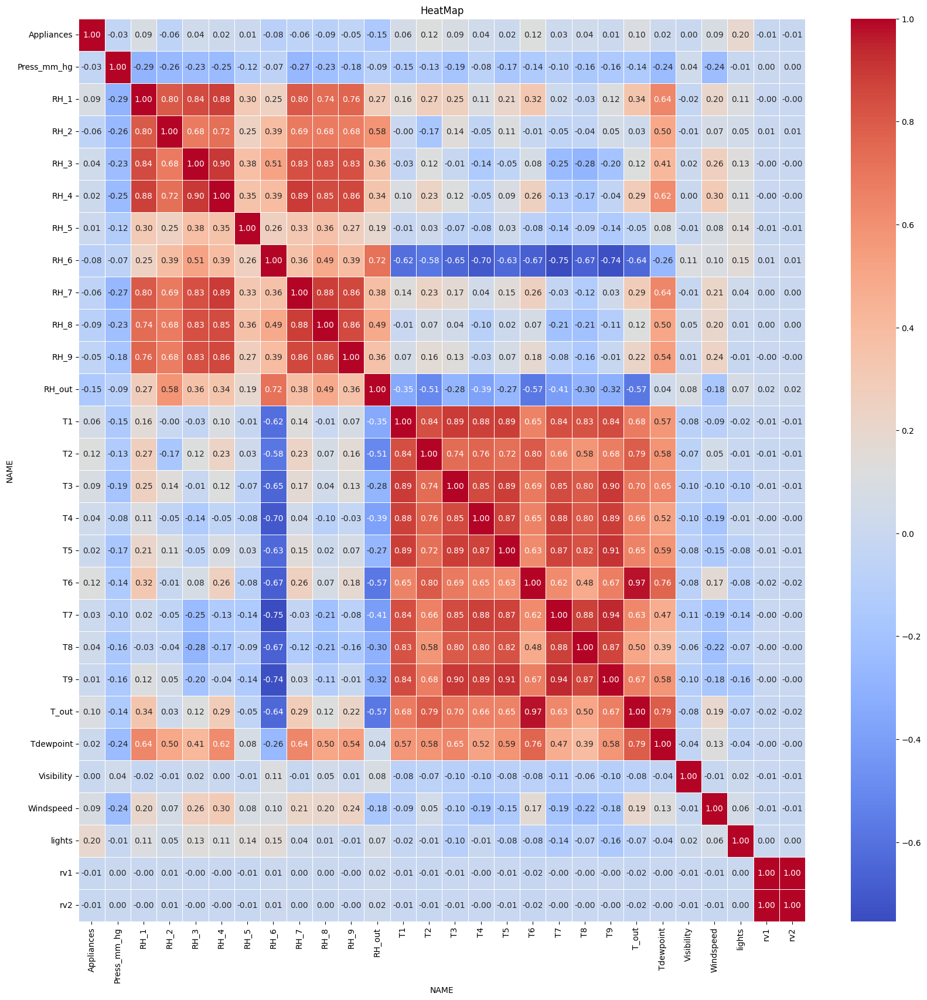

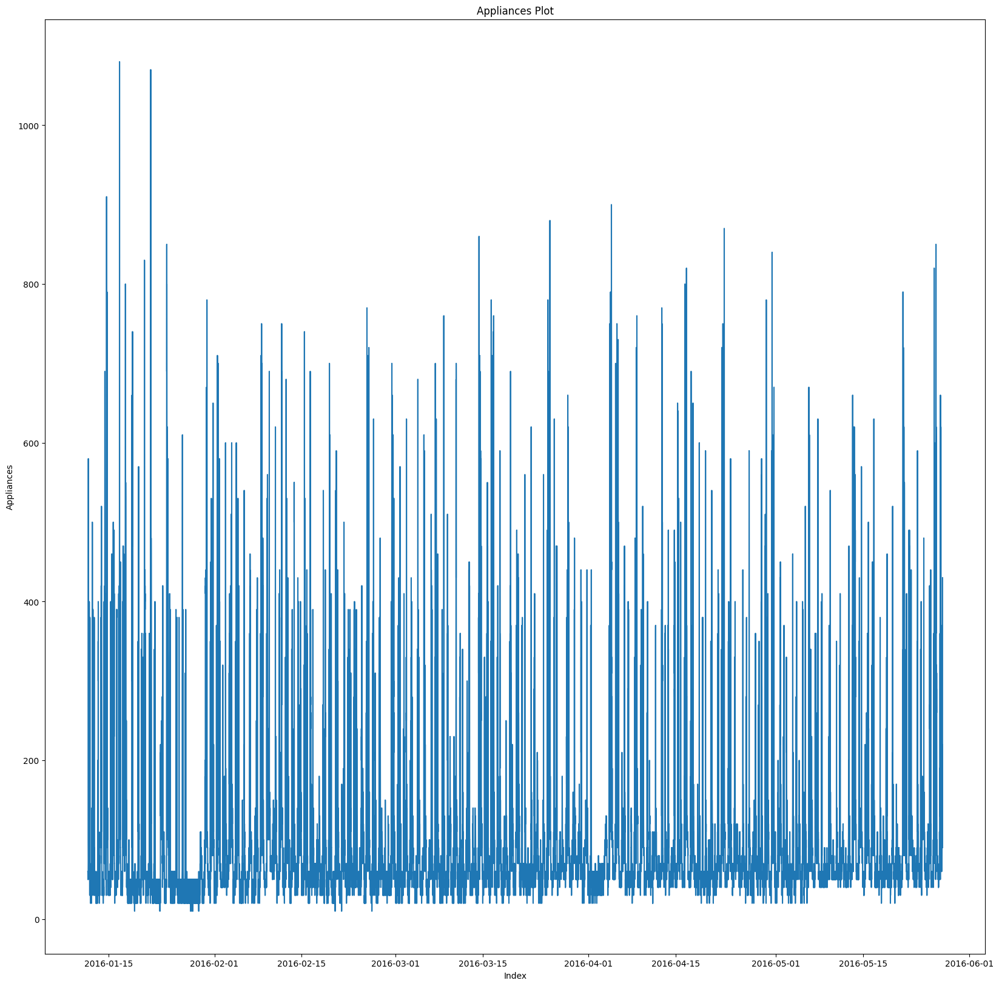

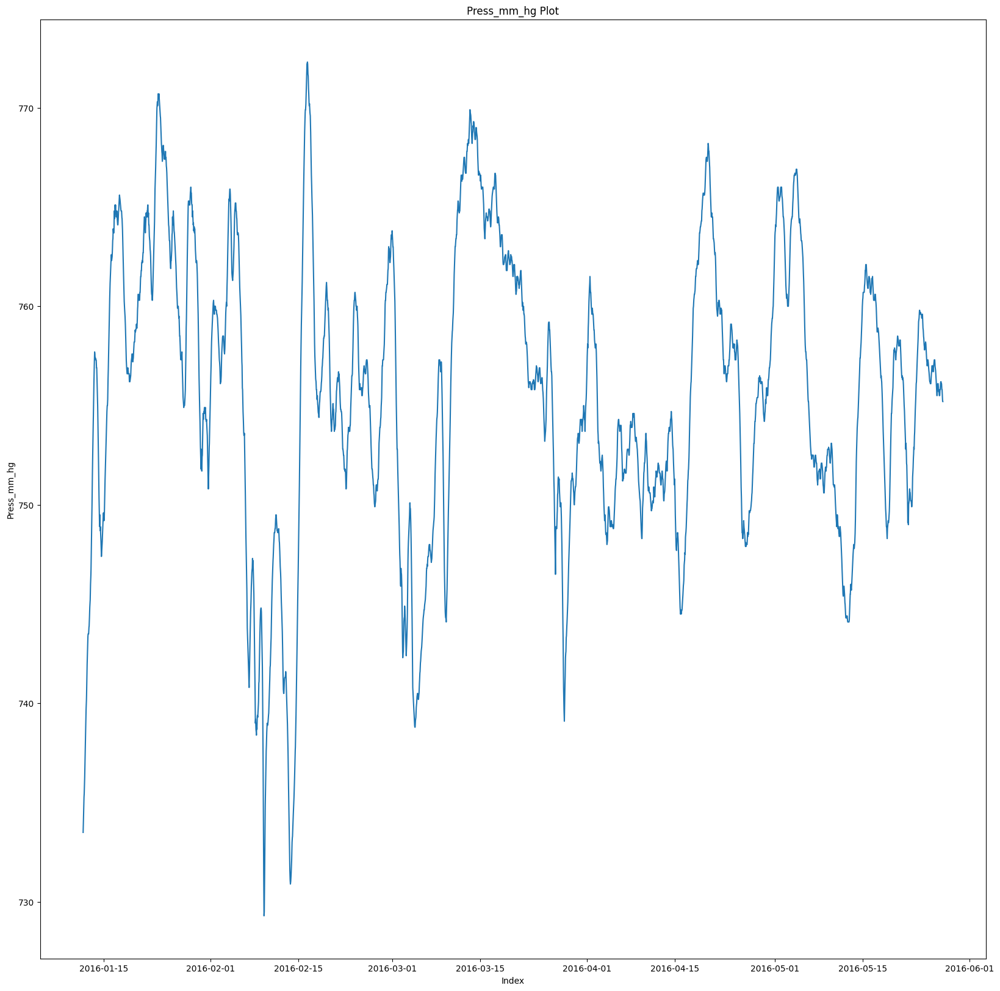

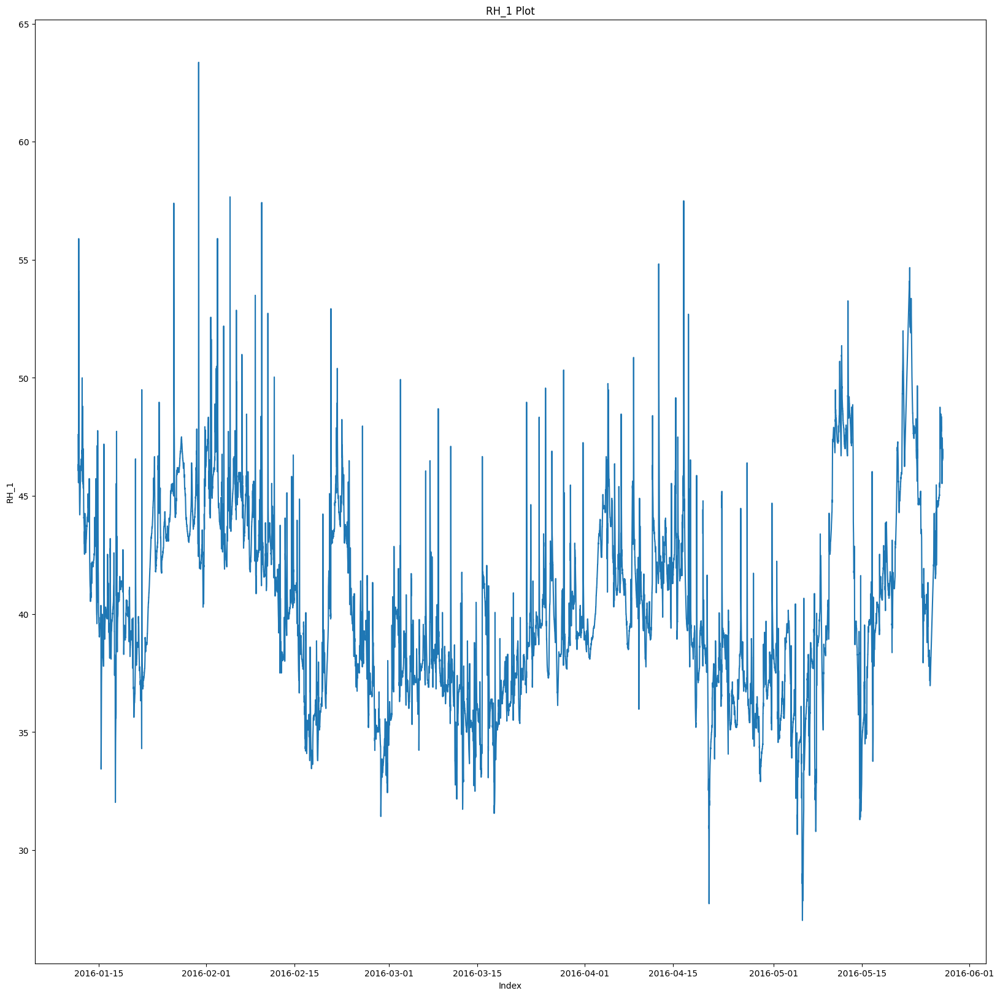

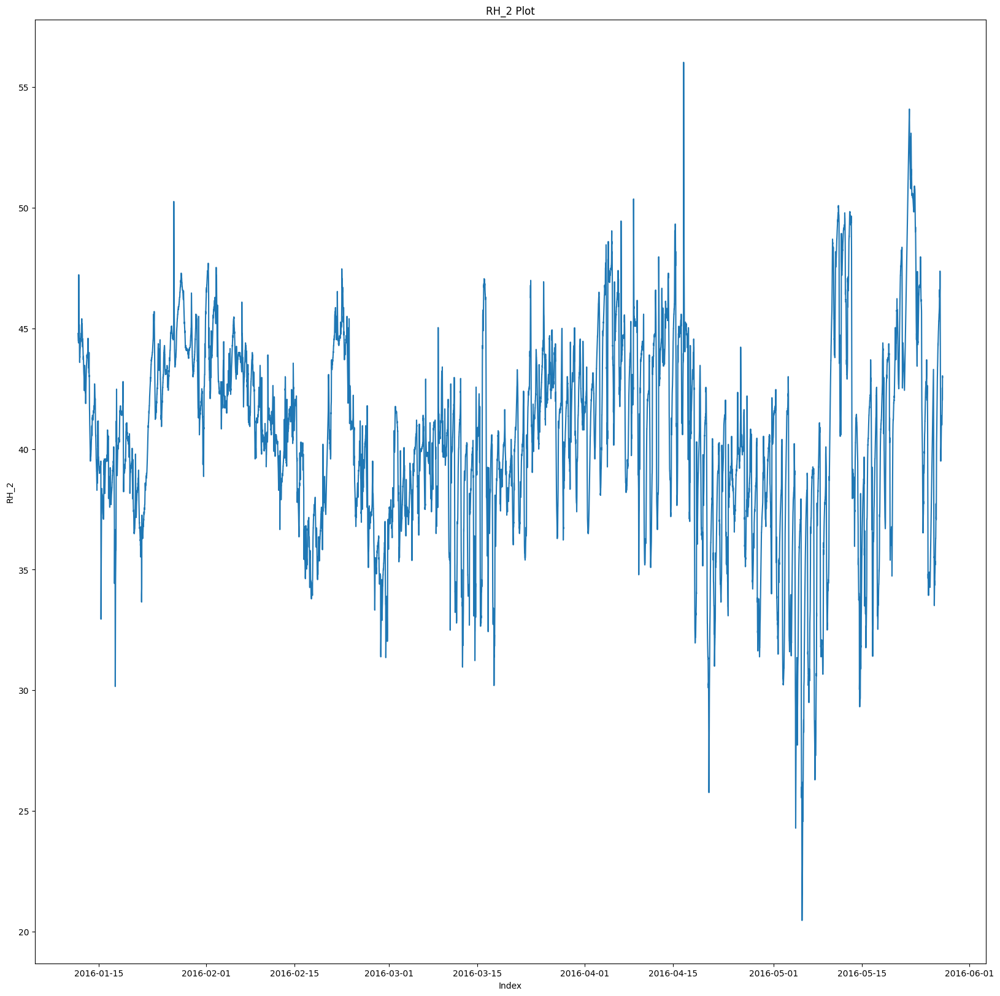

...

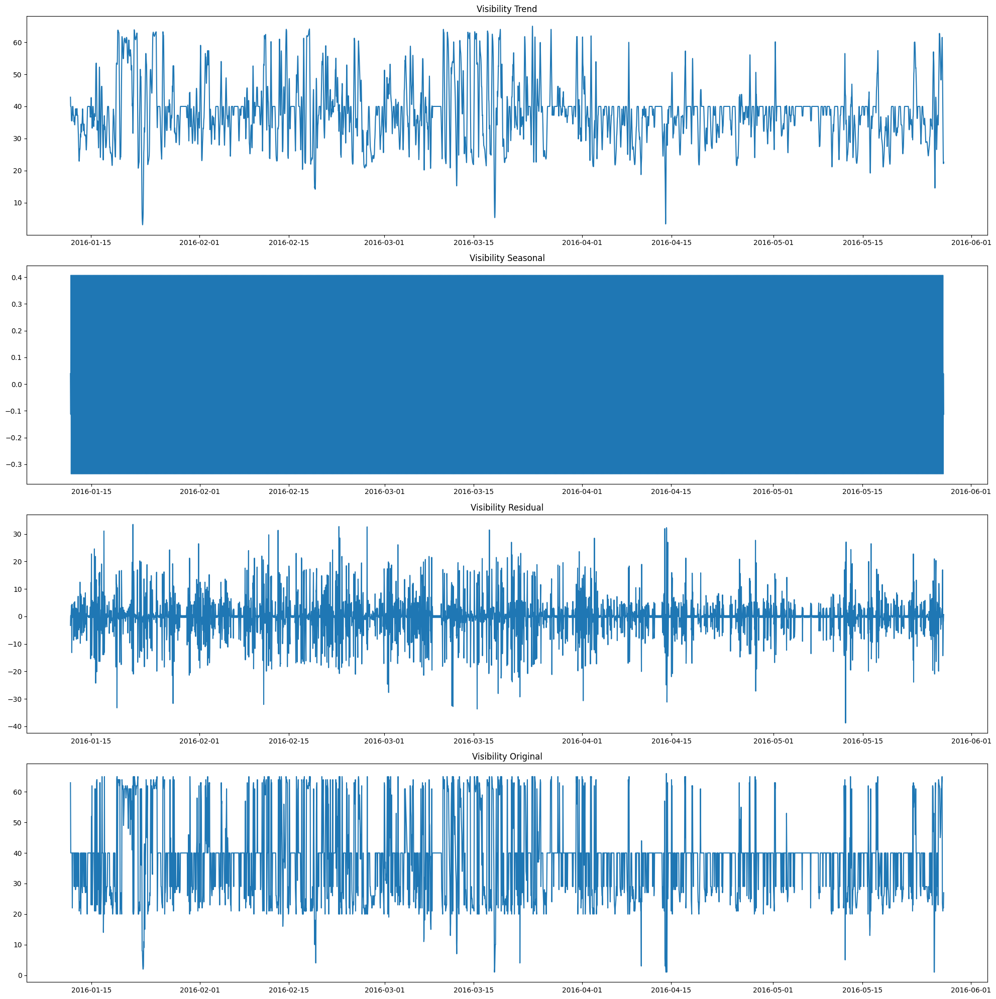

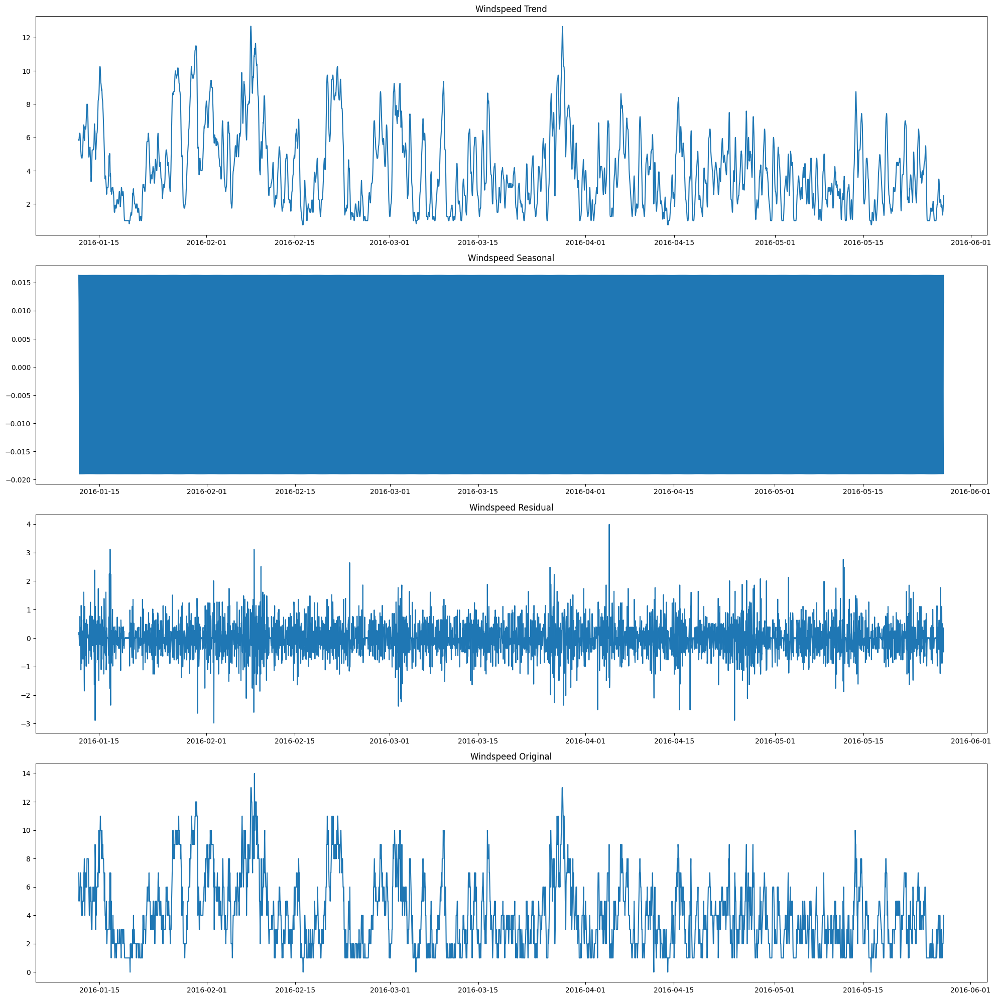

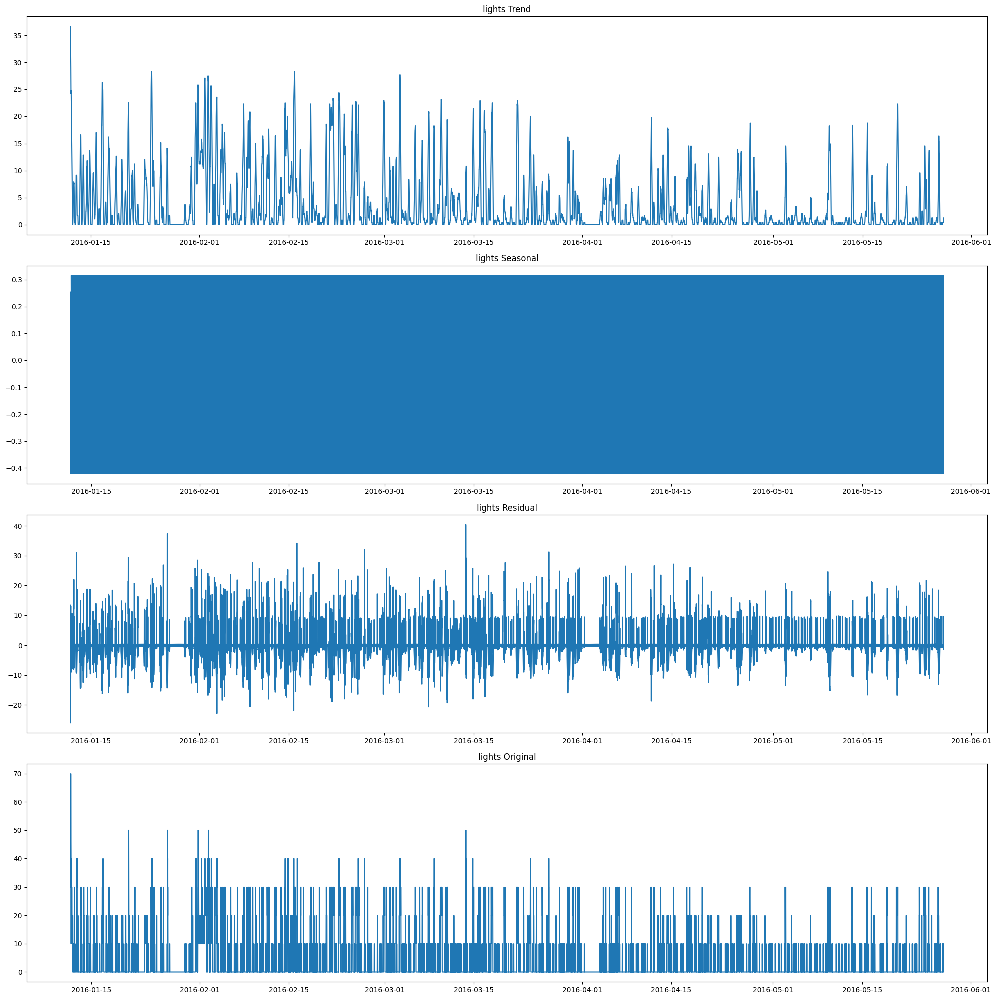

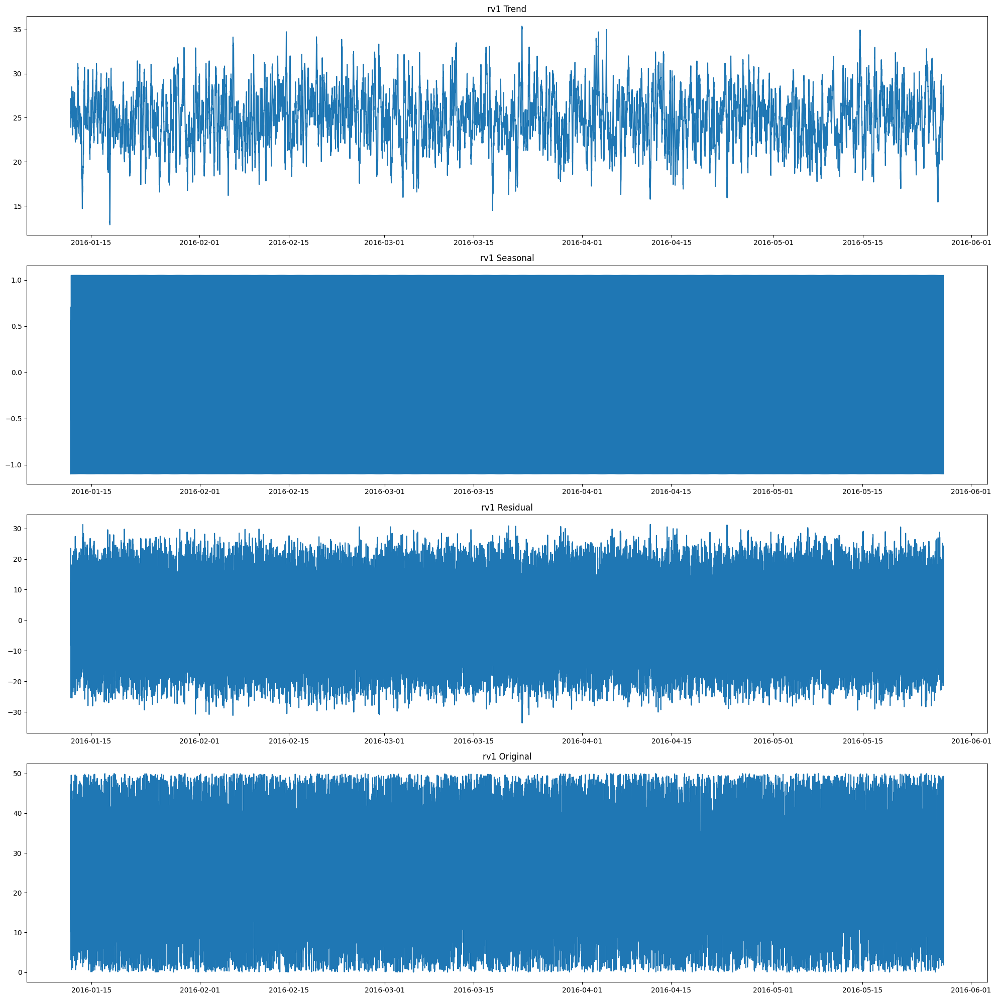

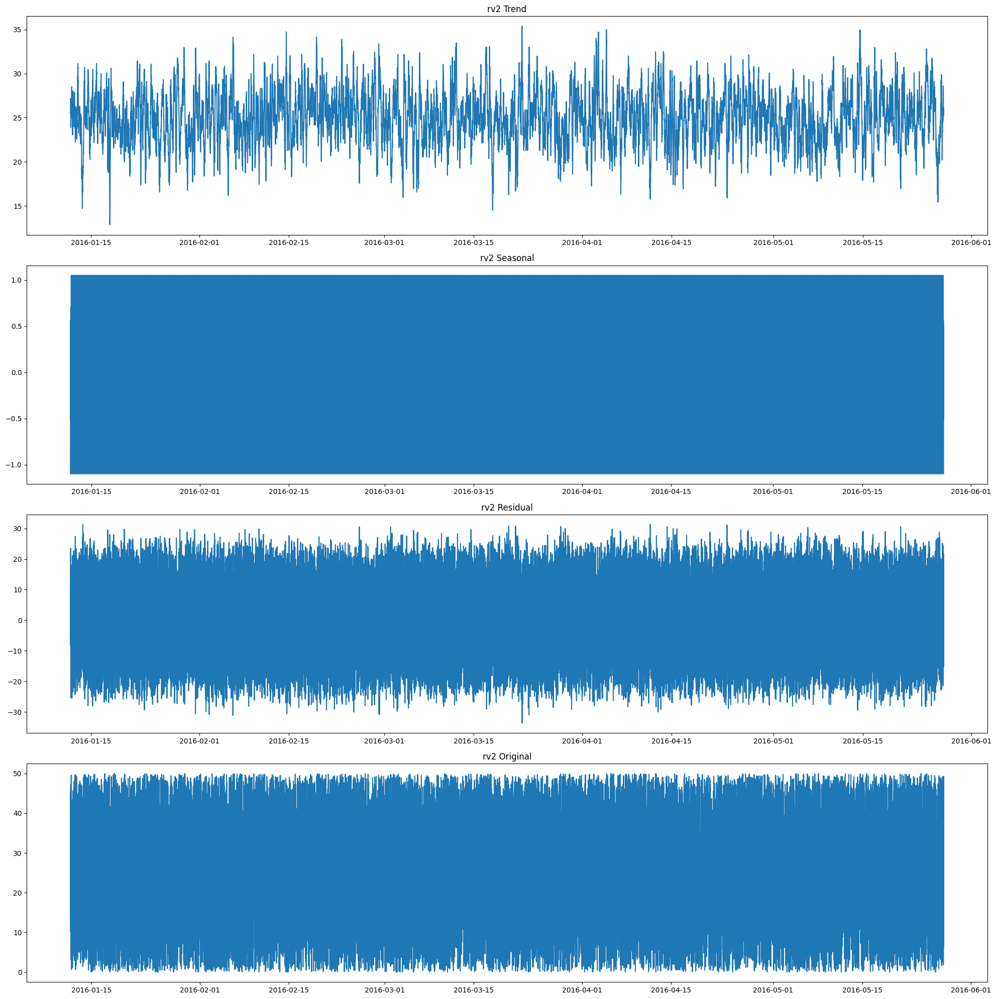

Save Finish


In [7]:
# Adjust period based on data for Decomposition
period = 24
# Plot width 
x_size = 20
# Plot height
y_size = 20
# Set option
# 1.HeatMap, 2.plot, 3.Decomposition, 4.All 
option = 4

# Set Start Function
Visualize_EDA(df, period, x_size, y_size, option)

## Check Statistical_Test

In [8]:
# Check ADF Test
adf_test(df)


adf_test for column: Appliances
ADF Statistic: -21.616378198036106
p-value: 0.0
Critical Values: {'1%': -3.430681600227742, '5%': -2.8616865555329394, '10%': -2.566848007525354}
The series is stationary
------------------------------------------------------------------------------------------------------------------

adf_test for column: Press_mm_hg
ADF Statistic: -5.717285627128732
p-value: 7.072888713777985e-07
Critical Values: {'1%': -3.430682139184172, '5%': -2.86168679371923, '10%': -2.566848134307755}
The series is stationary
------------------------------------------------------------------------------------------------------------------

adf_test for column: RH_1
ADF Statistic: -5.224068797128916
p-value: 7.849940768688244e-06
Critical Values: {'1%': -3.430682021137803, '5%': -2.8616867415498466, '10%': -2.566848106538903}
The series is stationary
------------------------------------------------------------------------------------------------------------------

adf_test for co

In [9]:
# Check KPSS Test
kpss_test(df)


kpss_test for column: Appliances
KPSS Statistic: 0.03659866728530293
p-value: 0.1
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
The series is stationary
------------------------------------------------------------------------------------------------------------------

kpss_test for column: Press_mm_hg
KPSS Statistic: 0.24467971273747408
p-value: 0.1
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
The series is stationary
------------------------------------------------------------------------------------------------------------------

kpss_test for column: RH_1
KPSS Statistic: 1.5883924413829649
p-value: 0.01
Critical Values: {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
The series is not stationary
------------------------------------------------------------------------------------------------------------------

kpss_test for column: RH_2
KPSS Statistic: 0.7079375302280747
p-value: 0.012823860888356844
Critical Values: {'1

In [10]:
# Check PP Test
pp_test(df)


pp_test for column: Appliances

Phillips-Perron Test for column: Appliances
Test Statistic: -67.3934806282122
p-value: 0.0
The series is stationary
------------------------------------------------------------------------------------------------------------------

pp_test for column: Press_mm_hg

Phillips-Perron Test for column: Press_mm_hg
Test Statistic: -4.027849930452476
p-value: 0.0012715002745307881
The series is stationary
------------------------------------------------------------------------------------------------------------------

pp_test for column: RH_1

Phillips-Perron Test for column: RH_1
Test Statistic: -7.150392003139926
p-value: 3.1522481847387223e-10
The series is stationary
------------------------------------------------------------------------------------------------------------------

pp_test for column: RH_2

Phillips-Perron Test for column: RH_2
Test Statistic: -9.44624028123773
p-value: 4.747246335915721e-16
The series is stationary
------------------------

In [11]:
# Check ljung box Test
ljung_box_test(df, lags=10)


Ljung-Box Test for column: Appliances
p-value: 0.0
There is autocorrelation
------------------------------------------------------------------------------------------------------------------

Ljung-Box Test for column: Press_mm_hg
p-value: 0.0
There is autocorrelation
------------------------------------------------------------------------------------------------------------------

Ljung-Box Test for column: RH_1
p-value: 0.0
There is autocorrelation
------------------------------------------------------------------------------------------------------------------

Ljung-Box Test for column: RH_2
p-value: 0.0
There is autocorrelation
------------------------------------------------------------------------------------------------------------------

Ljung-Box Test for column: RH_3
p-value: 0.0
There is autocorrelation
------------------------------------------------------------------------------------------------------------------

Ljung-Box Test for column: RH_4
p-value: 0.0
There is au

In [12]:
# Check Arch Test
arch_test(df)


arch_test for column: Appliances
ARCH Model Results:

Omega (Intercept): 1.29e+03
Alpha[1] (ARCH Term): 1.0000

Model Evaluation:
Log-Likelihood: -108600.28
AIC (Akaike Information Criterion): 217206.55
BIC (Bayesian Information Criterion): 217230.22

Interpretation:
Omega value is low, indicating a low level of volatility in the model.
Alpha[1] is high, suggesting that past variances have a strong effect on current volatility.
------------------------------------------------------------------------------------------------------------------

arch_test for column: Press_mm_hg
ARCH Model Results:

Omega (Intercept): 1.39e-03
Alpha[1] (ARCH Term): 1.0000

Model Evaluation:
Log-Likelihood: -54131.98
AIC (Akaike Information Criterion): 108269.96
BIC (Bayesian Information Criterion): 108293.63

Interpretation:
Omega value is low, indicating a low level of volatility in the model.
Alpha[1] is high, suggesting that past variances have a strong effect on current volatility.
-------------------

In [13]:
# Check VIF Test
vif_test(df)

Variable: const, VIF: 20090.86, Interpretation: High multicollinearity
Variable: Appliances, VIF: 1.20, Interpretation: Low multicollinearity
Variable: Press_mm_hg, VIF: 1.41, Interpretation: Low multicollinearity
Variable: RH_1, VIF: 16.37, Interpretation: High multicollinearity
Variable: RH_2, VIF: 22.24, Interpretation: High multicollinearity
Variable: RH_3, VIF: 10.85, Interpretation: High multicollinearity
Variable: RH_4, VIF: 17.13, Interpretation: High multicollinearity
Variable: RH_5, VIF: 1.38, Interpretation: Low multicollinearity
Variable: RH_6, VIF: 10.01, Interpretation: High multicollinearity
Variable: RH_7, VIF: 10.83, Interpretation: High multicollinearity
Variable: RH_8, VIF: 8.58, Interpretation: Moderate multicollinearity
Variable: RH_9, VIF: 6.49, Interpretation: Moderate multicollinearity
Variable: RH_out, VIF: 49.26, Interpretation: High multicollinearity
Variable: T1, VIF: 19.67, Interpretation: High multicollinearity
Variable: T2, VIF: 28.98, Interpretation: Hig